# Action Recognition with TSM Network

## Instrucciones Generales

El siguiente práctico se debe realizar de forma **individual**. El formato de entregar es el **archivo .ipynb con todas las celdas ejecutadas**. Todas las preguntas deben ser respondida en celdas de texto. No se aceptará el _output_ de una celda de código como respuesta.

**Nombre compañero 1:** FRANCISCO MENA

**Fecha de entrega: Mayo 5 de 2021.**

El siguiente práctico cuanta con 1 secciones donde cada una contendrá 1 o más actividades a realizar. Algunas actividades correspondrán a escribir código y otras a responder preguntas. 

El practico debe entregarse de forma **Individual** en caso contrario obtendrán la mínima calificación (1). Asimismo, debe indicar su nombre donde se indica sino la práctica no será calificada.

## 1.0 Introduction

The goal of human activity recognition is to examine activities from video sequences or still images. One of the more important models of this area is described in the paper "[TSM: Temporal Shift Module for Efficient Video Understanding](https://arxiv.org/pdf/1811.08383.pdf)" by Ji Lin, Chuang Gan, Son Han. The paper was published as a ICCV 2019 conference paper.

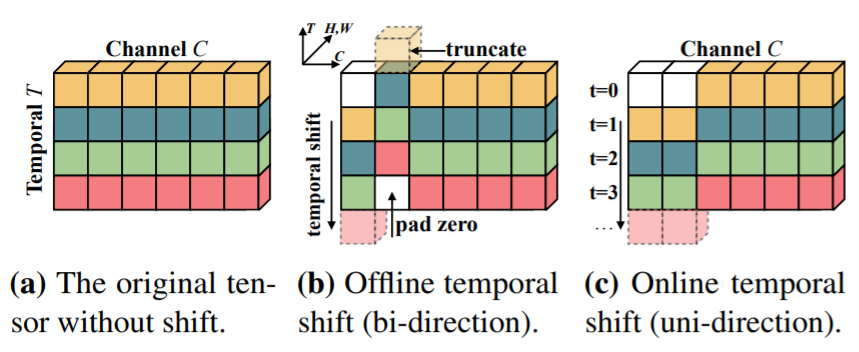


## 2.0 Setup

This tutorial is based on the official repo of TSM. This line clone this repo.

In [1]:
! git clone https://github.com/mit-han-lab/temporal-shift-module.git

import os
os.chdir("/content/temporal-shift-module")

Cloning into 'temporal-shift-module'...
remote: Enumerating objects: 222, done.
remote: Counting objects: 100% (37/37), done.
remote: Compressing objects: 100% (31/31), done.
remote: Total 222 (delta 7), reused 30 (delta 3), pack-reused 185
Receiving objects: 100% (222/222), 235.14 KiB | 9.04 MiB/s, done.
Resolving deltas: 100% (101/101), done.


We need to download the pre-trained models.

In [2]:
!wget https://file.lzhu.me/projects/tsm/models/TSM_kinetics_RGB_resnet50_shift8_blockres_avg_segment8_e50.pth

--2021-04-25 21:43:55--  https://file.lzhu.me/projects/tsm/models/TSM_kinetics_RGB_resnet50_shift8_blockres_avg_segment8_e50.pth
Resolving file.lzhu.me (file.lzhu.me)... 207.246.123.41
Connecting to file.lzhu.me (file.lzhu.me)|207.246.123.41|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 97587673 (93M) [application/octet-stream]
Saving to: ‘TSM_kinetics_RGB_resnet50_shift8_blockres_avg_segment8_e50.pth’

TSM_kinetics_RGB_re 100%[===================>]  93.07M  33.8MB/s    in 2.8s    

2021-04-25 21:43:58 (33.8 MB/s) - ‘TSM_kinetics_RGB_resnet50_shift8_blockres_avg_segment8_e50.pth’ saved [97587673/97587673]



Initialize the dependencies for this tutorial.

In [3]:
!pip install -q git+https://github.com/tensorflow/docs

     |████████████████████████████████| 1.0MB 8.2MB/s 


In [4]:
import argparse
import time

import torch.nn.parallel
import torch.optim
from sklearn.metrics import confusion_matrix
from ops.dataset import TSNDataSet
from ops.models import TSN
from ops.transforms import *
from ops import dataset_config
from torch.nn import functional as F

import tempfile, ssl, re
from urllib import request  # requires python3
import subprocess
import cv2
import imageio
from tensorflow_docs.vis import embed
import glob

## 3.0 Intance the TSM Model

Initial configuration for the TSM Network (provided by the authors for the specific weights downloaded).

In [5]:
args = {'weights':'/content/temporal-shift-module/TSM_kinetics_RGB_resnet50_shift8_blockres_avg_segment8_e50.pth', 
        'test_segments':8,
        'dense_sample':False,
        'twice_sample':False,
        'full_res':False,
        'test_crops':1,
        'coeff':None,
        'batch_size':1,
        'workers':8,
        'test_list':None,
        'csv_file':None,
        'softmax':True,
        'max_num':-1,
        'input_size':224,
        'crop_fusion_type':'avg',
        'gpus':None,
        'img_feature_dim': 256,
        'num_set_segments':1,
        'pretrain': 'imagenet'}

This function helps determine if the pre-trained model uses temporal shift or not using the checkpoint name.

In [6]:
def parse_shift_option_from_log_name(log_name):
    if 'shift' in log_name:
        strings = log_name.split('_')
        for i, s in enumerate(strings):
            if 'shift' in s:
                break
        return True, int(strings[i].replace('shift', '')), strings[i + 1]
    else:
        return False, None, None

In [7]:
weights_list = args['weights'].split(',')
test_segments_list = [args['test_segments']]
assert len(weights_list) == len(test_segments_list)
if args['coeff'] is None:
    coeff_list = [1] * len(weights_list)
else:
    coeff_list = [float(c) for c in args['coeff'].split(',')]

if args['test_list'] is not None:
    test_file_list = args['test_list'].split(',')
else:
    test_file_list = [None] * len(weights_list)

In this case, there are 400 classes because the model was trained with kinetics-400.

In [8]:
num_class = 400 

Intance the TSM model using the needed configuration for the pre-trained parameters.

In [9]:
data_iter_list = []
net_list = []
modality_list = []

total_num = None
for this_weights, this_test_segments, test_file in zip(weights_list, test_segments_list, test_file_list):
    is_shift, shift_div, shift_place = parse_shift_option_from_log_name(this_weights.split('/')[3])
    if 'RGB' in this_weights:
        modality = 'RGB'
    else:
        modality = 'Flow'
    this_arch = this_weights.split('TSM_')[1].split('_')[2]
    modality_list.append(modality)
    # num_class, args.train_list, val_list, root_path, prefix = dataset_config.return_dataset(args.dataset, modality)
    print('=> shift: {}, shift_div: {}, shift_place: {}'.format(is_shift, shift_div, shift_place))
    net = TSN(num_class, this_test_segments if is_shift else 1, modality,
              base_model=this_arch,
              consensus_type=args['crop_fusion_type'],
              img_feature_dim=args['img_feature_dim'],
              pretrain=args['pretrain'],
              is_shift=is_shift, shift_div=shift_div, shift_place=shift_place,
              non_local='_nl' in this_weights,
              )

=> shift: True, shift_div: 8, shift_place: blockres

    Initializing TSN with base model: resnet50.
    TSN Configurations:
        input_modality:     RGB
        num_segments:       8
        new_length:         1
        consensus_module:   avg
        dropout_ratio:      0.8
        img_feature_dim:    256
            
=> base model: resnet50


Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth



Adding temporal shift...
=> n_segment per stage: [8, 8, 8, 8]
=> Processing stage with 3 blocks residual
=> Using fold div: 8
=> Using fold div: 8
=> Using fold div: 8
=> Processing stage with 4 blocks residual
=> Using fold div: 8
=> Using fold div: 8
=> Using fold div: 8
=> Using fold div: 8
=> Processing stage with 6 blocks residual
=> Using fold div: 8
=> Using fold div: 8
=> Using fold div: 8
=> Using fold div: 8
=> Using fold div: 8
=> Using fold div: 8
=> Processing stage with 3 blocks residual
=> Using fold div: 8
=> Using fold div: 8
=> Using fold div: 8


In [10]:
if 'tpool' in this_weights:
    from ops.temporal_shift import make_temporal_pool
    make_temporal_pool(net.base_model, this_test_segments)  # since DataParallel


Load the pre-trained parameters

In [11]:
checkpoint = torch.load(this_weights)
checkpoint = checkpoint['state_dict']

# base_dict = {('base_model.' + k).replace('base_model.fc', 'new_fc'): v for k, v in list(checkpoint.items())}
base_dict = {'.'.join(k.split('.')[1:]): v for k, v in list(checkpoint.items())}
replace_dict = {'base_model.classifier.weight': 'new_fc.weight',
                'base_model.classifier.bias': 'new_fc.bias',
                }
for k, v in replace_dict.items():
    if k in base_dict:
        base_dict[v] = base_dict.pop(k)

net.load_state_dict(base_dict)

<All keys matched successfully>

## 4.0 Download video dataset

The following functions allow to fecth videos of the UCF101 dataset from the original repository. 

`list_ucf_videos` returns the list of the videos.
`fetch_ucf_video` returns one selected video, you need to give the name of the video.

In [12]:
# Utilities to fetch videos from UCF101 dataset
UCF_ROOT = "https://www.crcv.ucf.edu/THUMOS14/UCF101/UCF101/"
_VIDEO_LIST = None
_CACHE_DIR = '/content/data/'
# As of July 2020, crcv.ucf.edu doesn't use a certificate accepted by the
# default Colab environment anymore.
unverified_context = ssl._create_unverified_context()

def list_ucf_videos():
  """Lists videos available in UCF101 dataset."""
  global _VIDEO_LIST
  if not _VIDEO_LIST:
    index = request.urlopen(UCF_ROOT, context=unverified_context).read().decode("utf-8")
    videos = re.findall("(v_[\w_]+\.avi)", index)
    _VIDEO_LIST = sorted(set(videos))
  return list(_VIDEO_LIST)

def fetch_ucf_video(video):
  """Fetchs a video and cache into local filesystem."""
  cache_path = os.path.join(_CACHE_DIR, video)
  if not os.path.exists(cache_path):
    urlpath = request.urljoin(UCF_ROOT, video)
    print("Fetching %s => %s" % (urlpath, cache_path))
    data = request.urlopen(urlpath, context=unverified_context).read()
    open(cache_path, "wb").write(data)
  return cache_path

The to_gif function converts a video to a gif

In [13]:
# Utilities to open video files using CV2
def crop_center_square(frame):
  y, x = frame.shape[0:2]
  min_dim = min(y, x)
  start_x = (x // 2) - (min_dim // 2)
  start_y = (y // 2) - (min_dim // 2)
  return frame[start_y:start_y+min_dim,start_x:start_x+min_dim]

def load_video(path, max_frames=0, resize=(224, 224)):
  cap = cv2.VideoCapture(path)
  frames = []
  try:
    while True:
      ret, frame = cap.read()
      if not ret:
        break
      frame = crop_center_square(frame)
      frame = cv2.resize(frame, resize)
      frame = frame[:, :, [2, 1, 0]]
      frames.append(frame)
      
      if len(frames) == max_frames:
        break
  finally:
    cap.release()
  return np.array(frames) / 255.0

def to_gif(path):
  images = load_video(path)
  name = path.split('/')[-1:][0].split('.')[0]
  converted_images = np.clip(images * 255, 0, 255).astype(np.uint8)
  imageio.mimsave('/content/{}.gif'.format(name), converted_images, fps=25)
  return embed.embed_file('/content/{}.gif'.format(name))

In [14]:
# Get the list of videos in the dataset.
ucf_videos = list_ucf_videos()
  
categories = {}
for video in ucf_videos:
  category = video[2:-12]
  if category not in categories:
    categories[category] = []
  categories[category].append(video)
print("Found %d videos in %d categories." % (len(ucf_videos), len(categories)))

for category, sequences in categories.items():
  summary = ", ".join(sequences[:2])
  print("%-20s %4d videos (%s, ...)" % (category, len(sequences), summary))

Found 13320 videos in 101 categories.
ApplyEyeMakeup        145 videos (v_ApplyEyeMakeup_g01_c01.avi, v_ApplyEyeMakeup_g01_c02.avi, ...)
ApplyLipstick         114 videos (v_ApplyLipstick_g01_c01.avi, v_ApplyLipstick_g01_c02.avi, ...)
Archery               145 videos (v_Archery_g01_c01.avi, v_Archery_g01_c02.avi, ...)
BabyCrawling          132 videos (v_BabyCrawling_g01_c01.avi, v_BabyCrawling_g01_c02.avi, ...)
BalanceBeam           108 videos (v_BalanceBeam_g01_c01.avi, v_BalanceBeam_g01_c02.avi, ...)
BandMarching          155 videos (v_BandMarching_g01_c01.avi, v_BandMarching_g01_c02.avi, ...)
BaseballPitch         150 videos (v_BaseballPitch_g01_c01.avi, v_BaseballPitch_g01_c02.avi, ...)
BasketballDunk        131 videos (v_BasketballDunk_g01_c01.avi, v_BasketballDunk_g01_c02.avi, ...)
Basketball            134 videos (v_Basketball_g01_c01.avi, v_Basketball_g01_c02.avi, ...)
BenchPress            160 videos (v_BenchPress_g01_c01.avi, v_BenchPress_g01_c02.avi, ...)
Biking              

Create the data folders

In [15]:
os.mkdir('/content/data/')
os.mkdir('/content/data/videos/')

Download a video

In [16]:
video_path = fetch_ucf_video("v_HighJump_g01_c02.avi")

Fetching https://www.crcv.ucf.edu/THUMOS14/UCF101/UCF101/v_HighJump_g01_c02.avi => /content/data/v_HighJump_g01_c02.avi


## 5.0 Prepare the data

Video transformation for the network

In [17]:
input_size = net.scale_size if args['full_res'] else net.input_size
if args['test_crops'] == 1:
    cropping = torchvision.transforms.Compose([
        GroupScale(net.scale_size),
        GroupCenterCrop(input_size),
    ])
elif args['test_crops'] == 3:  # do not flip, so only 5 crops
    cropping = torchvision.transforms.Compose([
        GroupFullResSample(input_size, net.scale_size, flip=False)
    ])
elif args['test_crops'] == 5:  # do not flip, so only 5 crops
    cropping = torchvision.transforms.Compose([
        GroupOverSample(input_size, net.scale_size, flip=False)
    ])
elif args['test_crops'] == 10:
    cropping = torchvision.transforms.Compose([
        GroupOverSample(input_size, net.scale_size)
    ])
else:
    raise ValueError("Only 1, 5, 10 crops are supported while we got {}".format(args.test_crops))

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:258: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  "Argument interpolation should be of type InterpolationMode instead of int. "


Function to preprocess the videos

In [18]:
def vid2jpg(file_name, video_file_path, dst_class_path):

    name, ext = os.path.splitext(file_name)
    dst_directory_path = os.path.join(dst_class_path, name)

    try:
        if os.path.exists(dst_directory_path):
            if not os.path.exists(os.path.join(dst_directory_path, 'img_00001.jpg')):
                subprocess.call('rm -r \"{}\"'.format(dst_directory_path), shell=True)
                print('remove {}'.format(dst_directory_path))
                os.mkdir(dst_directory_path)
            else:
                print('*** convert has been done: {}'.format(dst_directory_path))
                return
        else:
            os.mkdir(dst_directory_path)
    except:
        print(dst_directory_path)
        return
    cmd = 'ffmpeg -i \"{}\" -threads 1 -vf scale=-1:331 -q:v 0 \"{}/img_%05d.jpg\"'.format(video_file_path, dst_directory_path)
    # print(cmd)
    subprocess.call(cmd, shell=True,
                    stdout=subprocess.DEVNULL, stderr=subprocess.DEVNULL)

In [19]:
vid2jpg('v_HighJump_g01_c02.avi', '/content/data/v_HighJump_g01_c02.avi', '/content/data/videos/')

## 6.0 Dataset

This is the dataset class that is essential to carry the videos to the model.

In [20]:
# Code for "TSM: Temporal Shift Module for Efficient Video Understanding"
# arXiv:1811.08383
# Ji Lin*, Chuang Gan, Song Han
# {jilin, songhan}@mit.edu, ganchuang@csail.mit.edu

import torch.utils.data as data

from PIL import Image
import os
import numpy as np
from numpy.random import randint


class VideoRecord(object):
    def __init__(self, row):
        self._data = row

    @property
    def path(self):
        return self._data[0]

    @property
    def num_frames(self):
        return int(self._data[1])

    @property
    def label(self):
        return int(self._data[2])


class TSNDataSet(data.Dataset):
    def __init__(self, root_path,
                 num_segments=3, new_length=1, modality='RGB',
                 image_tmpl='img_{:05d}.jpg', transform=None,
                 random_shift=True, test_mode=False,
                 remove_missing=False, dense_sample=False, twice_sample=False):

        self.root_path = root_path
        self.num_segments = num_segments
        self.new_length = new_length
        self.modality = modality
        self.image_tmpl = image_tmpl
        self.transform = transform
        self.random_shift = random_shift
        self.test_mode = test_mode
        self.remove_missing = remove_missing
        self.dense_sample = dense_sample  # using dense sample as I3D
        self.twice_sample = twice_sample  # twice sample for more validation
        if self.dense_sample:
            print('=> Using dense sample for the dataset...')
        if self.twice_sample:
            print('=> Using twice sample for the dataset...')

        if self.modality == 'RGBDiff':
            self.new_length += 1  # Diff needs one more image to calculate diff

        self._parse_list()

    def _load_image(self, directory, idx):
        if self.modality == 'RGB' or self.modality == 'RGBDiff':
            try:
                return [Image.open(os.path.join(self.root_path, directory, self.image_tmpl.format(idx))).convert('RGB')]
            except Exception:
                print('error loading image:', os.path.join(self.root_path, directory, self.image_tmpl.format(idx)))
                return [Image.open(os.path.join(self.root_path, directory, self.image_tmpl.format(1))).convert('RGB')]
        elif self.modality == 'Flow':
            if self.image_tmpl == 'flow_{}_{:05d}.jpg':  # ucf
                x_img = Image.open(os.path.join(self.root_path, directory, self.image_tmpl.format('x', idx))).convert(
                    'L')
                y_img = Image.open(os.path.join(self.root_path, directory, self.image_tmpl.format('y', idx))).convert(
                    'L')
            elif self.image_tmpl == '{:06d}-{}_{:05d}.jpg':  # something v1 flow
                x_img = Image.open(os.path.join(self.root_path, '{:06d}'.format(int(directory)), self.image_tmpl.
                                                format(int(directory), 'x', idx))).convert('L')
                y_img = Image.open(os.path.join(self.root_path, '{:06d}'.format(int(directory)), self.image_tmpl.
                                                format(int(directory), 'y', idx))).convert('L')
            else:
                try:
                    # idx_skip = 1 + (idx-1)*5
                    flow = Image.open(os.path.join(self.root_path, directory, self.image_tmpl.format(idx))).convert(
                        'RGB')
                except Exception:
                    print('error loading flow file:',
                          os.path.join(self.root_path, directory, self.image_tmpl.format(idx)))
                    flow = Image.open(os.path.join(self.root_path, directory, self.image_tmpl.format(1))).convert('RGB')
                # the input flow file is RGB image with (flow_x, flow_y, blank) for each channel
                flow_x, flow_y, _ = flow.split()
                x_img = flow_x.convert('L')
                y_img = flow_y.convert('L')

            return [x_img, y_img]

    def _parse_list(self):
        # check the frame number is large >3:
        tmp = os.listdir(self.root_path)
        # if not self.test_mode or self.remove_missing:
        #     tmp = [item for item in tmp if int(item[1]) >= 3]
        path_frames = []
        num_frames = []
        for item in tmp:
            path_frame = os.path.join(self.root_path, item)
            path_frames.append(path_frame)
            num_frames.append(len(os.listdir(path_frame)))

        self.video_list = [VideoRecord([path_frames[i],num_frames[i]]) for i in range(len(tmp))]
        if self.image_tmpl == '{:06d}-{}_{:05d}.jpg':
            for v in self.video_list:
                v._data[1] = int(v._data[1]) / 2
        print('video number:%d' % (len(self.video_list)))

    def _sample_indices(self, record):
        """

        :param record: VideoRecord
        :return: list
        """
        if self.dense_sample:  # i3d dense sample
            sample_pos = max(1, 1 + record.num_frames - 64)
            t_stride = 64 // self.num_segments
            start_idx = 0 if sample_pos == 1 else np.random.randint(0, sample_pos - 1)
            offsets = [(idx * t_stride + start_idx) % record.num_frames for idx in range(self.num_segments)]
            return np.array(offsets) + 1
        else:  # normal sample
            average_duration = (record.num_frames - self.new_length + 1) // self.num_segments
            if average_duration > 0:
                offsets = np.multiply(list(range(self.num_segments)), average_duration) + randint(average_duration,
                                                                                                  size=self.num_segments)
            elif record.num_frames > self.num_segments:
                offsets = np.sort(randint(record.num_frames - self.new_length + 1, size=self.num_segments))
            else:
                offsets = np.zeros((self.num_segments,))
            return offsets + 1

    def _get_val_indices(self, record):
        if self.dense_sample:  # i3d dense sample
            sample_pos = max(1, 1 + record.num_frames - 64)
            t_stride = 64 // self.num_segments
            start_idx = 0 if sample_pos == 1 else np.random.randint(0, sample_pos - 1)
            offsets = [(idx * t_stride + start_idx) % record.num_frames for idx in range(self.num_segments)]
            return np.array(offsets) + 1
        else:
            if record.num_frames > self.num_segments + self.new_length - 1:
                tick = (record.num_frames - self.new_length + 1) / float(self.num_segments)
                offsets = np.array([int(tick / 2.0 + tick * x) for x in range(self.num_segments)])
            else:
                offsets = np.zeros((self.num_segments,))
            return offsets + 1

    def _get_test_indices(self, record):
        if self.dense_sample:
            sample_pos = max(1, 1 + record.num_frames - 64)
            t_stride = 64 // self.num_segments
            start_list = np.linspace(0, sample_pos - 1, num=10, dtype=int)
            offsets = []
            for start_idx in start_list.tolist():
                offsets += [(idx * t_stride + start_idx) % record.num_frames for idx in range(self.num_segments)]
            return np.array(offsets) + 1
        elif self.twice_sample:
            tick = (record.num_frames - self.new_length + 1) / float(self.num_segments)

            offsets = np.array([int(tick / 2.0 + tick * x) for x in range(self.num_segments)] +
                               [int(tick * x) for x in range(self.num_segments)])

            return offsets + 1
        else:
            tick = (record.num_frames - self.new_length + 1) / float(self.num_segments)
            offsets = np.array([int(tick / 2.0 + tick * x) for x in range(self.num_segments)])
            return offsets + 1

    def __getitem__(self, index):
        record = self.video_list[index]
        # check this is a legit video folder
        if self.image_tmpl == 'flow_{}_{:05d}.jpg':
            file_name = self.image_tmpl.format('x', 1)
            full_path = os.path.join(record.path, file_name)
        elif self.image_tmpl == '{:06d}-{}_{:05d}.jpg':
            file_name = self.image_tmpl.format(int(record.path), 'x', 1)
            full_path = os.path.join('{:06d}'.format(int(record.path)), file_name)
        else:
            file_name = self.image_tmpl.format(1)
            full_path = os.path.join(record.path, file_name)

        while not os.path.exists(full_path):
            print('################## Not Found:', os.path.join(record.path, file_name))
            index = np.random.randint(len(self.video_list))
            record = self.video_list[index]
            if self.image_tmpl == 'flow_{}_{:05d}.jpg':
                file_name = self.image_tmpl.format('x', 1)
                full_path = os.path.join(self.root_path, record.path, file_name)
            elif self.image_tmpl == '{:06d}-{}_{:05d}.jpg':
                file_name = self.image_tmpl.format(int(record.path), 'x', 1)
                full_path = os.path.join(self.root_path, '{:06d}'.format(int(record.path)), file_name)
            else:
                file_name = self.image_tmpl.format(1)
                full_path = os.path.join(self.root_path, record.path, file_name)

        if not self.test_mode:
            segment_indices = self._sample_indices(record) if self.random_shift else self._get_val_indices(record)
        else:
            segment_indices = self._get_test_indices(record)
        return self.get(record, segment_indices)

    def get(self, record, indices):

        images = list()
        to_image = []
        for seg_ind in indices:
            p = int(seg_ind)
            for i in range(self.new_length):
                seg_imgs = self._load_image(record.path, p)
                images.extend(seg_imgs)
                if p < record.num_frames:
                    p += 1

        process_data = self.transform(images)
        return process_data
    def __len__(self):
        return len(self.video_list)


We instance the dataset and the dataloader 

In [21]:
dataset_test = TSNDataSet('/content/data/videos', num_segments=this_test_segments,
                       new_length=1 if modality == "RGB" else 5,
                       modality=modality,
                       image_tmpl='img_{:05d}.jpg',
                       test_mode=True,
                       remove_missing=len(weights_list) == 1,
                       transform=torchvision.transforms.Compose([
                           cropping,
                           Stack(roll=(this_arch in ['BNInception', 'InceptionV3'])),
                           ToTorchFormatTensor(div=(this_arch not in ['BNInception', 'InceptionV3'])),
                           GroupNormalize(net.input_mean, net.input_std),
                       ]), dense_sample=args['dense_sample'], twice_sample=args['twice_sample'])

data_loader = torch.utils.data.DataLoader(dataset_test, batch_size=args['batch_size'], shuffle=False, pin_memory=True)

video number:1


## 7.0 Get an inference with the model

We set the device (GPU if it is available or CPU in other cases)

In [22]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

set the model in eval mode

In [23]:
net.eval()

Do the predictions

In [24]:
with torch.no_grad():
    outputs = []
    for data in data_loader:
        batch_size = args['batch_size']
        num_crop = args['test_crops']
        if args['dense_sample']:
            num_crop *= 10  # 10 clips for testing when using dense sample

        if args['twice_sample']:
            num_crop *= 2

        if modality == 'RGB':
            length = 3
        elif modality == 'Flow':
            length = 10
        elif modality == 'RGBDiff':
            length = 18
        else:
            raise ValueError("Unknown modality "+ modality)

        data_in = data.view(-1, length, data.size(2), data.size(3))
        if is_shift:
            data_in = data_in.view(batch_size * num_crop, this_test_segments, length, data_in.size(2), data_in.size(3))
        rst = net(data_in)
        rst = rst.reshape(batch_size, num_crop, -1).mean(1)

        if args['softmax']:
            # take the softmax to normalize the output to probability
            rst = F.softmax(rst, dim=1)

        rst = rst.data.cpu().numpy().copy()

        if net.is_shift:
            rst = rst.reshape(batch_size, num_class)
        else:
            rst = rst.reshape((batch_size, -1, num_class)).mean(axis=1).reshape((batch_size, num_class))

        outputs.append(rst)

## 8.0 Show the predictions

In [25]:
KINETICS_URL = "https://raw.githubusercontent.com/deepmind/kinetics-i3d/master/data/label_map.txt"
with request.urlopen(KINETICS_URL) as obj:
  labels = [line.decode("utf-8").strip() for line in obj.readlines()]
print("Found %d labels." % len(labels))

Found 400 labels.


In [26]:
aviFilenamesList = glob.glob('/content/data/*.avi')

In [27]:
index = 0


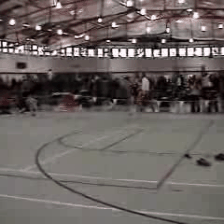

In [28]:
to_gif(aviFilenamesList[index])

In [29]:
print("Top 5 actions:")
k=5
probabilities = outputs[index].reshape(outputs[index].shape[1])
for i in np.argsort(probabilities)[::-1][:k]:
    print(f"  {labels[i]:22}: {probabilities[i] * 100:5.2f}%")

Top 5 actions:
  high jump             : 99.92%
  gymnastics tumbling   :  0.02%
  pole vault            :  0.01%
  hurdling              :  0.01%
  dunking basketball    :  0.01%


## 9.0 Questions

Now it is your turn. Reuse the code of the section 3, 4, 5, 6 and 7 to download and predict the action of the following video: v_PlayingGuitar_g01_c01.avi

In [50]:
## Write the code here ...
video_path = fetch_ucf_video("v_PlayingGuitar_g01_c01.avi")
os.mkdir('/content/data/video_tarea/')
vid2jpg('v_PlayingGuitar_g01_c01.avi', '/content/data/v_PlayingGuitar_g01_c01.avi', '/content/data/video_tarea/')

In [51]:
dataset_test = TSNDataSet('/content/data/video_tarea', num_segments=this_test_segments,
                       new_length=1 if modality == "RGB" else 5,
                       modality=modality,
                       image_tmpl='img_{:05d}.jpg',
                       test_mode=True,
                       remove_missing=len(weights_list) == 1,
                       transform=torchvision.transforms.Compose([
                           cropping,
                           Stack(roll=(this_arch in ['BNInception', 'InceptionV3'])),
                           ToTorchFormatTensor(div=(this_arch not in ['BNInception', 'InceptionV3'])),
                           GroupNormalize(net.input_mean, net.input_std),
                       ]), dense_sample=args['dense_sample'], twice_sample=args['twice_sample'])

data_loader = torch.utils.data.DataLoader(dataset_test, batch_size=args['batch_size'], shuffle=False, pin_memory=True)

video number:1


In [52]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

In [53]:
net.eval()

In [54]:
with torch.no_grad():
    outputs = []
    for data in data_loader:
        batch_size = args['batch_size']
        num_crop = args['test_crops']
        if args['dense_sample']:
            num_crop *= 10  # 10 clips for testing when using dense sample

        if args['twice_sample']:
            num_crop *= 2

        if modality == 'RGB':
            length = 3
        elif modality == 'Flow':
            length = 10
        elif modality == 'RGBDiff':
            length = 18
        else:
            raise ValueError("Unknown modality "+ modality)

        data_in = data.view(-1, length, data.size(2), data.size(3))
        if is_shift:
            data_in = data_in.view(batch_size * num_crop, this_test_segments, length, data_in.size(2), data_in.size(3))
        rst = net(data_in)
        rst = rst.reshape(batch_size, num_crop, -1).mean(1)

        if args['softmax']:
            # take the softmax to normalize the output to probability
            rst = F.softmax(rst, dim=1)

        rst = rst.data.cpu().numpy().copy()

        if net.is_shift:
            rst = rst.reshape(batch_size, num_class)
        else:
            rst = rst.reshape((batch_size, -1, num_class)).mean(axis=1).reshape((batch_size, num_class))

        outputs.append(rst)

In [58]:
aviFilenamesList = glob.glob('/content/data/v_PlayingGuitar_g01_c01.avi')


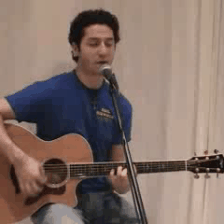

In [59]:
index = 0
to_gif(aviFilenamesList[index])

In [60]:
print("Top 5 actions:")
k=5
probabilities = outputs[index].reshape(outputs[index].shape[1])
for i in np.argsort(probabilities)[::-1][:k]:
    print(f"  {labels[i]:22}: {probabilities[i] * 100:5.2f}%")

Top 5 actions:
  playing guitar        : 61.82%
  strumming guitar      : 25.88%
  busking               :  6.57%
  recording music       :  2.24%
  singing               :  1.14%



Based on this tutorial and the class, answer the questions.


1. Is the TSM model a 3d or 2d model?



**RESPUESTA** TSM es un modelo 2D, solo usa redes de 2 dimensiones

2. What does the Temporal Shift Module (TSM) work?

**RESPUESTA** Un TSM comparte información entre frames de segmentos sequenciales para recuperar la sequencia temporal del video, pero manteniendo la ventaja de la simplicidad de redes 2D.

3. What is the difference between online and ofline shift?

**RESPUESTA**

ONLINE: se transmite informacion de un frame al frame siguiente, pero no viceversa. No tenemos informacion del frame siguiente, por lo que no podemos pasar su informacion al frame anterior.

OFFLINE: Se comparte informacion entre dos frames de dos segmentos sequenciales entre uno y otro, en ambas direcciones. 

4. What does the TSN propose?

**RESPUESTA** TSN propone dividir los videos en segmentos, y elegir un frame en forma aleatoria de cada segmento para entrenar la red. Cada epoca se elige otro frame en forma aleatoria. De esta manera se espera que la red aprenda de los mejores frames, que entregan mas informacion. 

5. What are the differences between the segment sampling and uniform sampling?

**RESPUESTA**

En *uniform sampling* se elige un frame del video cada cierto intervalo fijo, por ejemplo, se elige uno de cada 5 frames. Y luego con estos frames se entrena el modelo.

En *segment sampling*, primero se divide el video en un número de segmentos. Luego, de cada segmento se elige un frame en forma aleatoria. Y en cada época del entrenamiento se elige otro frame de cada segmento en forma aleatoria. De esta manera se espera que el modelo aprenda de los frames que entregan más información. 